# Importing libraries

In [1]:
import pandas as pd
import numpy as np
import datetime
import warnings

warnings.filterwarnings('ignore')
warnings.filterwarnings("ignore", message="numpy.ufunc size changed")

import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("whitegrid")

%matplotlib inline

pd.set_option('display.max_columns', None)
from sklearn import linear_model
from sklearn.linear_model import LinearRegression
import statsmodels.formula.api as smf
from sklearn.metrics import mean_squared_error, r2_score, accuracy_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Reading the Data

In [2]:
!pip install xlrd

In [3]:
data = pd.read_excel('regression_data.xls') 
data#.head()

,id,date,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,price
0,7129300520,2014-10-13,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650,221900
1,6414100192,2014-12-09,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639,538000
2,5631500400,2015-02-25,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062,180000
3,2487200875,2014-12-09,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000,604000
4,1954400510,2015-02-18,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503,510000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21592,263000018,2014-05-21,3,2.50,1530,1131,3.0,0,0,3,8,1530,0,2009,0,98103,47.6993,-122.346,1530,1509,360000
21593,6600060120,2015-02-23,4,2.50,2310,5813,2.0,0,0,3,8,2310,0,2014,0,98146,47.5107,-122.362,1830,7200,400000
21594,1523300141,2014-06-23,2,0.75,1020,1350,2.0,0,0,3,7,1020,0,2009,0,98144,47.5944,-122.299,1020,2007,402101
21595,291310100,2015-01-16,3,2.50,1600,2388,2.0,0,0,3,8,1600,0,2004,0,98027,47.5345,-122.069,1410,1287,400000


# Exploratory Data Analysis (EDA)
- Check column names
- Check data shape
- Check duplicates
- Check null values
- Check data types
- Visualise the data

In [4]:
data.columns

Index(['id', 'date', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot',
       'floors', 'waterfront', 'view', 'condition', 'grade', 'sqft_above',
       'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long',
       'sqft_living15', 'sqft_lot15', 'price'],
      dtype='object')

In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   id             21597 non-null  int64         
 1   date           21597 non-null  datetime64[ns]
 2   bedrooms       21597 non-null  int64         
 3   bathrooms      21597 non-null  float64       
 4   sqft_living    21597 non-null  int64         
 5   sqft_lot       21597 non-null  int64         
 6   floors         21597 non-null  float64       
 7   waterfront     21597 non-null  int64         
 8   view           21597 non-null  int64         
 9   condition      21597 non-null  int64         
 10  grade          21597 non-null  int64         
 11  sqft_above     21597 non-null  int64         
 12  sqft_basement  21597 non-null  int64         
 13  yr_built       21597 non-null  int64         
 14  yr_renovated   21597 non-null  int64         
 15  zipcode        2159

In [6]:
data.shape 

(21597, 21)

In [7]:
data.nunique()

id               21420
date               372
bedrooms            12
bathrooms           29
sqft_living       1034
sqft_lot          9776
floors               6
waterfront           2
view                 5
condition            5
grade               11
sqft_above         942
sqft_basement      306
yr_built           116
yr_renovated        70
zipcode             70
lat               5033
long               751
sqft_living15      777
sqft_lot15        8682
price             3622
dtype: int64

In [8]:
data.isnull().any()  

id               False
date             False
bedrooms         False
bathrooms        False
sqft_living      False
sqft_lot         False
floors           False
waterfront       False
view             False
condition        False
grade            False
sqft_above       False
sqft_basement    False
yr_built         False
yr_renovated     False
zipcode          False
lat              False
long             False
sqft_living15    False
sqft_lot15       False
price            False
dtype: bool

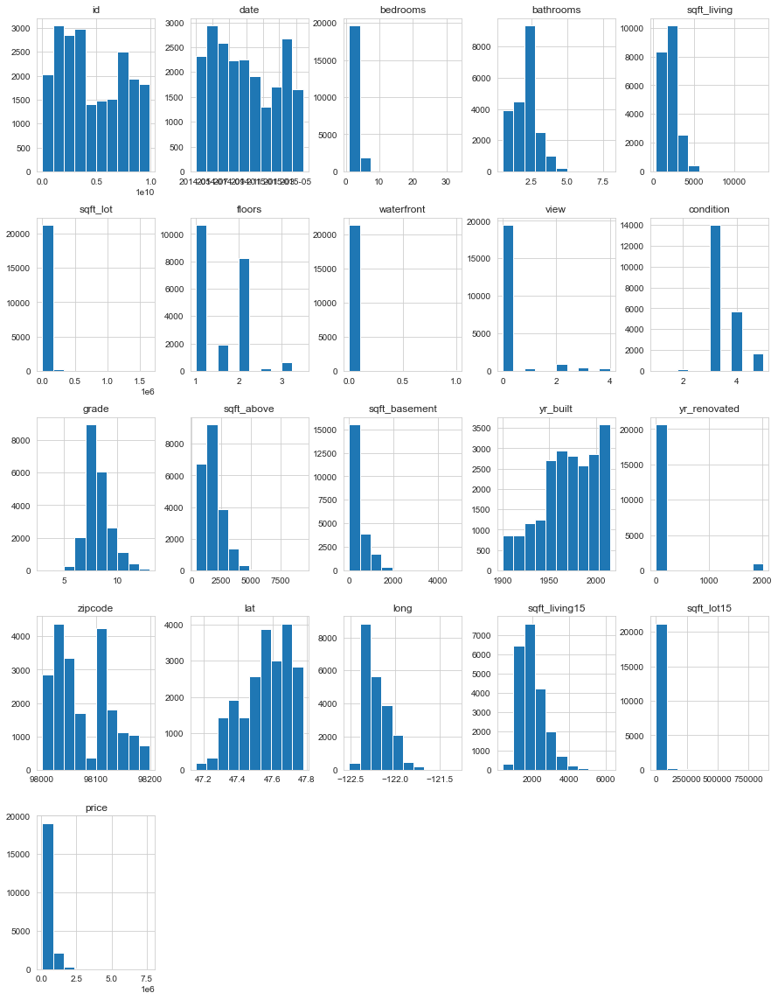

In [9]:
data.hist(figsize = (15,20));

Before we dive into exploring the data, we’ll want to set the context of the analysis. One good way to do this is with exploratory charts or maps. In this case, we’ll map out the positions of the houses, which will help us understand the problem we’re exploring.

In the below code, we:

- Setup a map.
- Add a marker to the map for each house sold in the area.
- Display the map.

In [10]:
pip install folium

Note: you may need to restart the kernel to use updated packages.


In [11]:
import folium 
from folium import plugins # for map visualization
from folium.plugins import MarkerCluster
MarkerCluster()
houses_map = folium.Map(location = [data['lat'].mean(), data['long'].mean()], zoom_start = 10)
marker_cluster = MarkerCluster().add_to(houses_map)
MAX_RECORDS = 100
for name, row in data.iterrows():
    folium.Marker([row["lat"], row["long"]], 
                  popup="Sold for {0}$ on: {1}. Features: {2} sqft, {3} bedrooms, {4} bathrooms, year built: {5}"\
                  .format(row["price"], row["date"], row['sqft_living'], 
                          row['bedrooms'], row['bathrooms'], row['yr_built'])).add_to(marker_cluster)
    
houses_map.save('houses.html')
houses_map

## Initial observations:
- We can see the distribution of attributes and categorise the numerical attributes to continuous and discrete features:
    - Continuous Attributes:
        price
        sqft_living
        sqft_lot
        sqft_above
        sqft_basement
        yr_built
        yr_renovated
    - Discrete Attributes :
        bedrooms
        bathrooms
        floors
        waterfront
        view
        condition
        grade
- Date is the only categorical variable. It does not seem to be useful as it is the date the house was sold (not the date the house was built, as one would expect). Thus, I may drop this.
- latitude and longtitude are redundant. I think I will drop lat/long.
- yr_renovated seems to have a lot of 0's. May turn this to a boolean like waterfront (0 hasn't been renovated, 1 if it has been).

In [12]:
data['year_sold'] = pd.DatetimeIndex(data['date']).year
data

,id,date,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,price,year_sold
0,7129300520,2014-10-13,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650,221900,2014
1,6414100192,2014-12-09,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639,538000,2014
2,5631500400,2015-02-25,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062,180000,2015
3,2487200875,2014-12-09,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000,604000,2014
4,1954400510,2015-02-18,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503,510000,2015
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21592,263000018,2014-05-21,3,2.50,1530,1131,3.0,0,0,3,8,1530,0,2009,0,98103,47.6993,-122.346,1530,1509,360000,2014
21593,6600060120,2015-02-23,4,2.50,2310,5813,2.0,0,0,3,8,2310,0,2014,0,98146,47.5107,-122.362,1830,7200,400000,2015
21594,1523300141,2014-06-23,2,0.75,1020,1350,2.0,0,0,3,7,1020,0,2009,0,98144,47.5944,-122.299,1020,2007,402101,2014
21595,291310100,2015-01-16,3,2.50,1600,2388,2.0,0,0,3,8,1600,0,2004,0,98027,47.5345,-122.069,1410,1287,400000,2015


In [13]:
data=data.drop(['id', 'date', 'lat', 'long'], axis=1)
data.columns

Index(['bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'waterfront', 'view', 'condition', 'grade', 'sqft_above',
       'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'sqft_living15',
       'sqft_lot15', 'price', 'year_sold'],
      dtype='object')

In [14]:
data['house_age']= data['year_sold'] - data['yr_built']
data.head()

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,sqft_living15,sqft_lot15,price,year_sold,house_age
0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,98178,1340,5650,221900,2014,59
1,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,98125,1690,7639,538000,2014,63
2,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,98028,2720,8062,180000,2015,82
3,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,98136,1360,5000,604000,2014,49
4,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,98074,1800,7503,510000,2015,28


In [15]:
data['renovated'] = np.where(data['yr_renovated']>0, 1, 0)

In [16]:
data.drop(['yr_renovated'], axis =1, inplace=True)

In [17]:
data.drop(['yr_built'], axis =1, inplace=True)
data.head()

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,zipcode,sqft_living15,sqft_lot15,price,year_sold,house_age,renovated
0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,98178,1340,5650,221900,2014,59,0
1,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,98125,1690,7639,538000,2014,63,1
2,2,1.00,770,10000,1.0,0,0,3,6,770,0,98028,2720,8062,180000,2015,82,0
3,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,98136,1360,5000,604000,2014,49,0
4,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,98074,1800,7503,510000,2015,28,0


### Remove unreasonable outlier with characteristics bedroom == 33

In [18]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 18 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   bedrooms       21597 non-null  int64  
 1   bathrooms      21597 non-null  float64
 2   sqft_living    21597 non-null  int64  
 3   sqft_lot       21597 non-null  int64  
 4   floors         21597 non-null  float64
 5   waterfront     21597 non-null  int64  
 6   view           21597 non-null  int64  
 7   condition      21597 non-null  int64  
 8   grade          21597 non-null  int64  
 9   sqft_above     21597 non-null  int64  
 10  sqft_basement  21597 non-null  int64  
 11  zipcode        21597 non-null  int64  
 12  sqft_living15  21597 non-null  int64  
 13  sqft_lot15     21597 non-null  int64  
 14  price          21597 non-null  int64  
 15  year_sold      21597 non-null  int64  
 16  house_age      21597 non-null  int64  
 17  renovated      21597 non-null  int32  
dtypes: flo

# EDA: Multicollinearity
Check the correlation of independent variables for our model to identify and remove the highly correlated variables

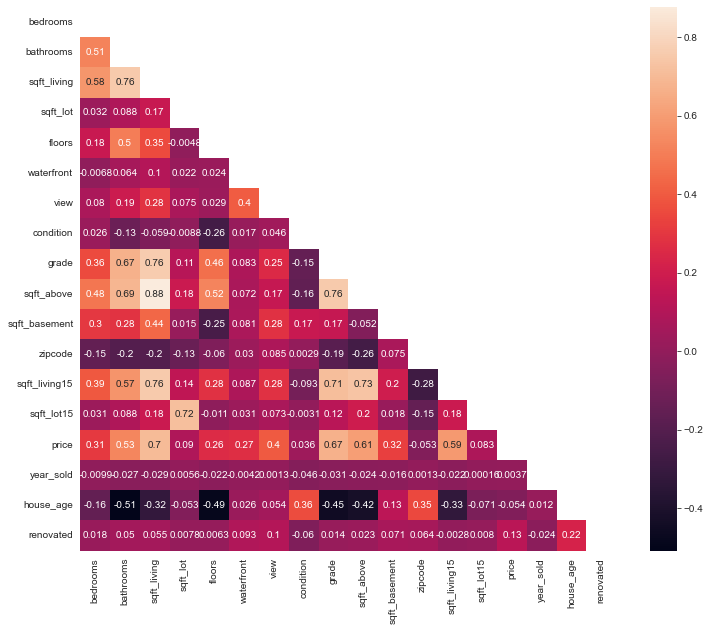

In [19]:
correlations_matrix = data.corr()
mask = np.zeros_like(correlations_matrix)
mask[np.triu_indices_from(mask)] = True
fig, ax = plt.subplots(figsize=(12, 10))
ax = sns.heatmap(correlations_matrix, mask=mask, annot=True)
plt.show()

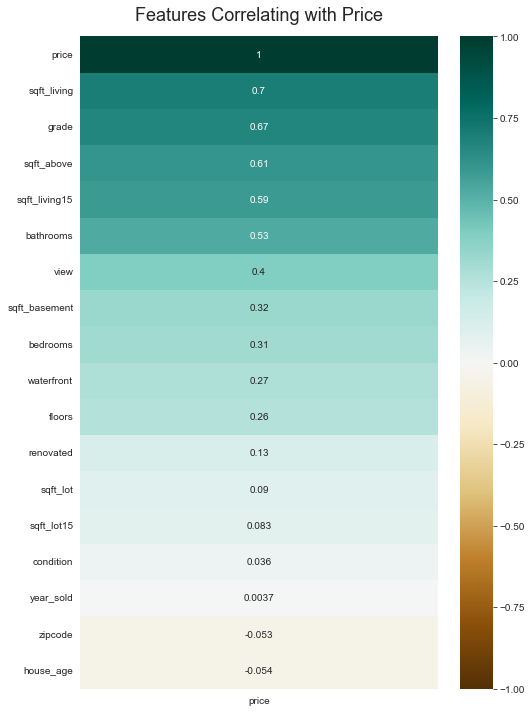

In [20]:
plt.figure(figsize=(8, 12))
heatmap = sns.heatmap(data.corr()[['price']].sort_values(by='price', ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Features Correlating with Price', fontdict={'fontsize':18}, pad=16);

### Price is related more by sqft_living ,grade, sqft_above when compared to other attributes

### Analyzing some of the continuous data

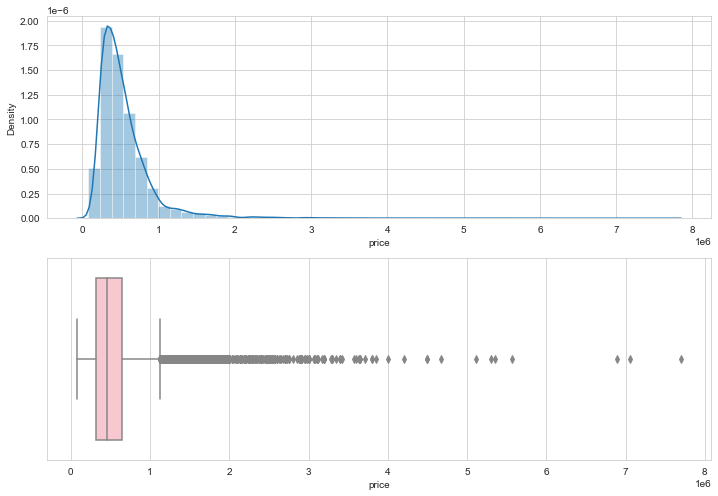

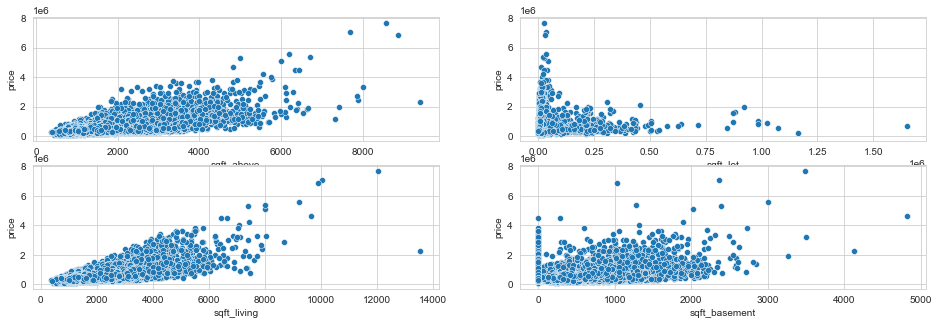

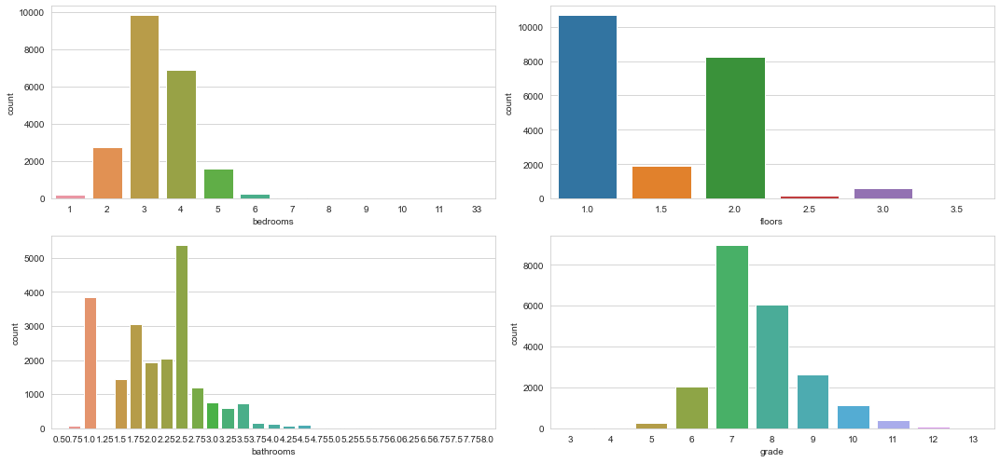

In [21]:
#visualizing house prices
fig = plt.figure(figsize=(10,7))
fig.add_subplot(2,1,1)
sns.distplot(data['price'])
fig.add_subplot(2,1,2)
sns.boxplot(data['price'], color = 'pink')
plt.tight_layout()
#visualizing continuos data
fig = plt.figure(figsize=(16,5))
fig.add_subplot(2,2,1)
sns.scatterplot(data['sqft_above'], data['price'])
fig.add_subplot(2,2,2)
sns.scatterplot(data['sqft_lot'],data['price'])
fig.add_subplot(2,2,3)
sns.scatterplot(data['sqft_living'],data['price'])
fig.add_subplot(2,2,4)
sns.scatterplot(data['sqft_basement'],data['price'])
#visualizing discrete data
fig = plt.figure(figsize=(15,7))
fig.add_subplot(2,2,1)
sns.countplot(data['bedrooms'])
fig.add_subplot(2,2,2)
sns.countplot(data['floors'])
fig.add_subplot(2,2,3)
sns.countplot(data['bathrooms'])
fig.add_subplot(2,2,4)
sns.countplot(data['grade'])
plt.tight_layout()

<AxesSubplot:xlabel='year_sold'>

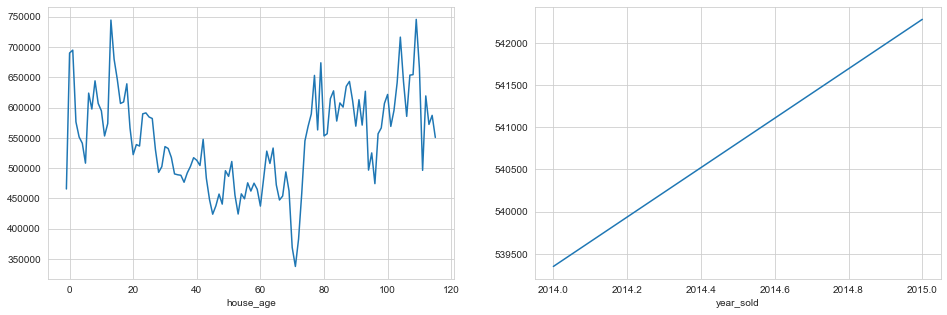

In [22]:
#data visualization house price vs house age and years
fig = plt.figure(figsize=(16,5))
fig.add_subplot(1,2,1)
data.groupby('house_age').mean()['price'].plot()
fig.add_subplot(1,2,2)
data.groupby('year_sold').mean()['price'].plot()

## Dataset Preparation (Splitting and Scaling) 

In [23]:
X = data.drop(['price'], axis = 1).values
y = data['price'].values
#splitting Train and Test 

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=1/3, random_state=42)
X_train, X_test, y_train, y_test=train_test_split(X, y, test_size=1/3)


In [24]:
#standardization scaler - fit&transform on train, fit only on test
from sklearn.preprocessing import StandardScaler
s_scaler = StandardScaler()
X_train = s_scaler.fit_transform(X_train.astype(np.float))
X_test = s_scaler.transform(X_test.astype(np.float))


In [25]:
print(X_train.shape, y_train.shape)
print (X_test.shape, y_test.shape)

(14398, 17) (14398,)
(7199, 17) (7199,)


# Model Selection and Evaluation

### Model 1: Multiple Linear Regressions

In [26]:
# Multiple Liner Regression
from sklearn.linear_model import LinearRegression
regressor = LinearRegression()  
regressor.fit(X_train, y_train)
#evaluate the model (intercept and slope)
print(regressor.intercept_)
print(regressor.coef_)
#predicting the test set result
y_pred = regressor.predict(X_test)
#put results as a DataFrame
coeff_df = pd.DataFrame(regressor.coef_, data.drop('price',axis =1).columns, columns=['Coefficient']) 
coeff_df

540524.9538130313
[-40207.72971744  38077.44857429  77407.5221538    1480.50992835
  14333.60208056  49139.74436294  35906.64182565  16162.97303542
 136711.92769508  66149.64838367  37055.00168449   2137.12068899
  19983.4867204  -16616.52199066  11019.19250573 103857.17944753
   4655.83756076]


,Coefficient
bedrooms,-40207.729717
bathrooms,38077.448574
sqft_living,77407.522154
sqft_lot,1480.509928
floors,14333.602081
waterfront,49139.744363
view,35906.641826
condition,16162.973035
grade,136711.927695
sqft_above,66149.648384


In [27]:
#compare actual output values with predicted values
y_pred = regressor.predict(X_test)
df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred, 'Difference': y_test - y_pred})
df1 = df.head(10)
df1


,Actual,Predicted,Difference
0,370000,3.102304e+05,59769.609274
1,710000,7.512552e+05,-41255.230977
2,356000,2.142085e+05,141791.500402
3,585000,5.677902e+05,17209.808636
4,450000,3.463685e+05,103631.483894
5,339999,5.557124e+05,-215713.378733
6,349000,3.126360e+05,36363.962923
7,291000,3.690924e+05,-78092.389577
8,1050000,1.116777e+06,-66777.150268
9,260000,2.416500e+05,18350.027789


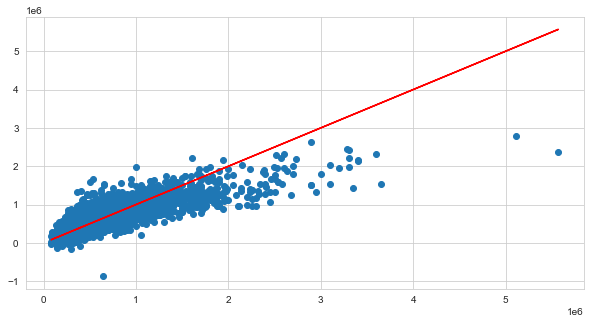

In [28]:
# Visualizing Our predictions
fig = plt.figure(figsize=(10,5))
plt.scatter(y_test,y_pred)
# Perfect predictions
plt.plot(y_test,y_test,'r')

In [29]:
# evaluate the performance of the algorithm (MAE - MSE - RMSE)
from sklearn import metrics
print('MAE:', metrics.mean_absolute_error(y_test, y_pred))  
print('MSE:', metrics.mean_squared_error(y_test, y_pred))  
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))
print('VarScore:',metrics.explained_variance_score(y_test,y_pred))


MAE: 139265.32287004482
MSE: 44178817541.20134
RMSE: 210187.57703822874
VarScore: 0.6581502646568886


### Model 2: KNN model

In [30]:
from sklearn.neighbors import KNeighborsRegressor
for k in range(1,11):
    neighbors = KNeighborsRegressor(n_neighbors=k)
    neighbors.fit(X_train, y_train)
    prediction_knn = neighbors.predict(X_train)
    print("Length of Test Data:", len(y_test))
    print(f"{neighbors.__class__.__name__} k = {k}: Train -> {neighbors.score(X_train, y_train)}, Test -> {neighbors.score(X_test, y_test)}")

Length of Test Data: 7199
KNeighborsRegressor k = 1: Train -> 0.9998558412447773, Test -> 0.5600596748817864
Length of Test Data: 7199
KNeighborsRegressor k = 2: Train -> 0.8843392021655051, Test -> 0.6611271094802234
Length of Test Data: 7199
KNeighborsRegressor k = 3: Train -> 0.8393643029308916, Test -> 0.6867156561609736
Length of Test Data: 7199
KNeighborsRegressor k = 4: Train -> 0.8088581678864111, Test -> 0.7071196613071522
Length of Test Data: 7199
KNeighborsRegressor k = 5: Train -> 0.795434705411147, Test -> 0.7078638140300211
Length of Test Data: 7199
KNeighborsRegressor k = 6: Train -> 0.7820642367643047, Test -> 0.7115841964248182
Length of Test Data: 7199
KNeighborsRegressor k = 7: Train -> 0.7697794839863076, Test -> 0.7147968913933823
Length of Test Data: 7199
KNeighborsRegressor k = 8: Train -> 0.7633895437366769, Test -> 0.7134586724296506
Length of Test Data: 7199
KNeighborsRegressor k = 9: Train -> 0.75543945346052, Test -> 0.714178448719502
Length of Test Data: 71

In [31]:
model = KNeighborsRegressor()
model.fit(X_train, y_train)

#predicting the test set result
y_pred1 = model.predict(X_test)
df2 = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred1, 'Difference': y_test - y_pred1})
df3 = df2.head(10)
df3


,Actual,Predicted,Difference
0,370000,408000.0,-38000.0
1,710000,562785.0,147215.0
2,356000,284826.8,71173.2
3,585000,567300.0,17700.0
4,450000,419634.6,30365.4
5,339999,393660.0,-53661.0
6,349000,298300.0,50700.0
7,291000,426476.0,-135476.0
8,1050000,1035000.0,15000.0
9,260000,284900.0,-24900.0


In [32]:
print('MAE:', metrics.mean_absolute_error(y_test, y_pred1))  
print('MSE:', metrics.mean_squared_error(y_test, y_pred1))  
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, y_pred1)))
print('VarScore:',metrics.explained_variance_score(y_test,y_pred1))


MAE: 123633.70684817334
MSE: 37742866535.02182
RMSE: 194275.23397237697
VarScore: 0.7093418558246576


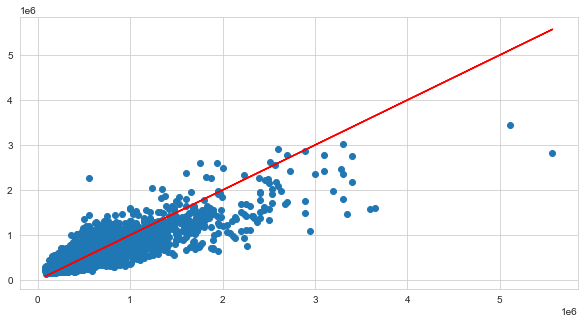

In [33]:
# Visualizing Our predictions
fig = plt.figure(figsize=(10,5))
plt.scatter(y_test,y_pred1)
# Perfect predictions
plt.plot(y_test,y_test,'r')

### Model 3: RandomForestRegressor model

In [34]:
from sklearn.preprocessing import scale
from sklearn.ensemble import RandomForestRegressor


rfr = RandomForestRegressor()
rfr.fit(X_train, y_train)
#predicting the test set result
ypred = rfr.predict(X_test)
dt = pd.DataFrame({'Actual': y_test, 'Predicted': ypred, 'Difference': y_test - ypred})
dt1 = dt.head(10)
dt1



,Actual,Predicted,Difference
0,370000,329903.20,40096.80
1,710000,636659.18,73340.82
2,356000,324144.40,31855.60
3,585000,577353.41,7646.59
4,450000,466959.57,-16959.57
5,339999,342329.05,-2330.05
6,349000,335870.00,13130.00
7,291000,359538.50,-68538.50
8,1050000,686334.28,363665.72
9,260000,264517.85,-4517.85


In [35]:
print('MAE:', metrics.mean_absolute_error(y_test, ypred))  
print('MSE:', metrics.mean_squared_error(y_test, ypred))  
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, ypred)))
print('VarScore:',metrics.explained_variance_score(y_test,ypred))


MAE: 86866.48093510672
MSE: 21531666603.745876
RMSE: 146736.72547711385
VarScore: 0.8333837281637951


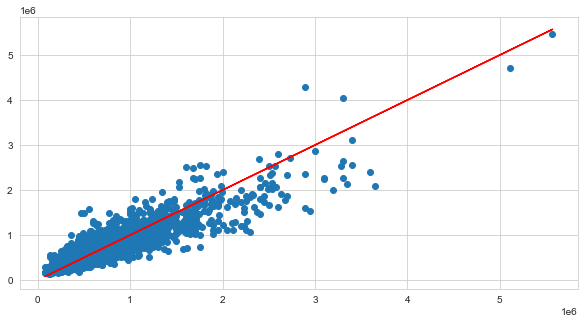

In [36]:
# Visualizing Our predictions
fig = plt.figure(figsize=(10,5))
plt.scatter(y_test,ypred)
# Perfect predictions
plt.plot(y_test,y_test,'r')

We have predicted the house price using 3 different model algorithms.

The score of our Multiple Linear Regression and KNeighbors Regressor are around 65% and 70% respectively, so these models had room for improvement. Then we got an accuracy of 81% with Random Forest Regression model.
Also, notice that RMSE (test error) is lower for Random Forest Regression model which shows that our prediction is closer to actual rating price.
Of course, this score can be improved through feature selection or using other regression models.